# Proyecto 2. Parte 1.
---
Reyna Yanet Hernandez Mada.

Profesor: Doctor Julio Waissman Vilanova.\
Curso: Ingeniería de Características

### Requerimientos.

Un archivo en html o en pdf con el EDA automático utilizando alguna herramienta.

Una libreta jupyter, o un Rmarkdown, en donde se realice un EDA más orientado a la relación de las variables, recuerda que no tiene que ser muy pulcro, solamente que permita la comunicación técnica entre colegas.
***
Un archivo en markdown, en el cual se especifique, La historia que queremos contar con nuestros datos,
KPI y otros indicadores que son útiles para contar la historia (al menos 1)desarrollar la metodología tal como se muestra en alguno de los formatos facilitados.\
Un borrador (puede ser una foto tomada de un cuaderno) de como pensamos hacer el tablero de visualización.
***

La problematica que se busca analizar en esta sección del proyecto, es `que impacto tiene la temperatura real en el consumo de energía del estado`.

La metodología de elaboración de KPI se puede encontrar aqui: [KPI](https://docs.google.com/document/d/1BYFZidLmrUkHKY_m1QUh9o1J1PECWUrA0CVVH4nbMG4/edit?usp=sharing)

Para la presente sección se incluyeron las siguientes fuentes:

* Archivo "DemandaGCRN *, el cual contiene la demanda electrica de la región.
* Archivo "Real_Diario" de conagua. Considerando los datos reales del estado.
* Archivos contenidos en la carpeta zip, incluye algunas variables en tiempo real, generados por Meteomatics.

In [44]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import os

#EDA libraries
from pandas_profiling import ProfileReport
from pandas_profiling.visualisation.plot import timeseries_heatmap

In [2]:
#set working directory  
os.chdir('./files')
print(os.getcwd())

/Users/yhmve/nrgy_feng/files


Archivo 1: Demanda real.

In [3]:
#exploring available files 01
df_demanda = pd.read_csv('DemandaGCRNO20221031.csv', delimiter=",")
df_demanda.tail(2)

,FECHA,H1,H2,H3,H4,H5,H6,H7,H8,H9,...,H15,H16,H17,H18,H19,H20,H21,H22,H23,H24
5781,30/10/2022,2629.53,2535.63,2450.04,2359.91,2294.59,2264.86,2231.41,2168.14,2165.34,...,2618.61,2656.02,2696.42,2690.23,2655.08,2750.37,2776.64,2809.72,2773.22,2680.07
5782,31/10/2022,2566.49,2467.76,2383.80,2317.80,2257.29,2241.29,2257.35,2256.47,2320.47,...,2914.07,2990.75,3038.08,3014.08,2934.74,2926.85,2894.38,2877.56,2843.08,2772.44


In [4]:
df_demanda.info() #reviewing columns and dtypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5783 entries, 0 to 5782
Data columns (total 25 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   FECHA   5783 non-null   object 
 1   H1      5783 non-null   float64
 2   H2      5783 non-null   float64
 3   H3      5783 non-null   float64
 4   H4      5783 non-null   float64
 5   H5      5783 non-null   float64
 6   H6      5783 non-null   float64
 7   H7      5783 non-null   float64
 8   H8      5783 non-null   float64
 9   H9      5783 non-null   float64
 10  H10     5783 non-null   float64
 11  H11     5783 non-null   float64
 12  H12     5783 non-null   float64
 13  H13     5783 non-null   float64
 14  H14     5783 non-null   float64
 15  H15     5783 non-null   float64
 16  H16     5783 non-null   float64
 17  H17     5783 non-null   float64
 18  H18     5783 non-null   float64
 19  H19     5783 non-null   float64
 20  H20     5783 non-null   float64
 21  H21     5783 non-null   float64
 22  

In [5]:
#check for null values
df_demanda.isnull().sum() # check for null values, there is none
df_demanda.describe() #review 

,H1,H2,H3,H4,H5,H6,H7,H8,H9,H10,...,H15,H16,H17,H18,H19,H20,H21,H22,H23,H24
count,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,...,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000
mean,2587.026291,2482.607166,2395.337398,2321.298703,2259.878649,2218.953688,2176.724837,2140.685528,2195.350645,2296.725708,...,2676.137047,2733.599877,2742.815923,2699.388506,2632.013244,2627.109064,2700.725637,2763.938153,2759.916894,2689.676913
std,901.941794,874.350368,839.920596,803.437776,764.184118,723.829645,658.376044,597.775994,614.682505,645.262486,...,869.747305,915.021938,926.094018,902.124466,837.778588,759.928137,777.631661,850.288766,899.233689,913.746691
min,1105.000000,1059.000000,1032.000000,1009.000000,1003.000000,1007.000000,1037.000000,1023.000000,959.000000,966.000000,...,1003.000000,1001.000000,1002.000000,1025.000000,1112.000000,1302.000000,1333.000000,1327.000000,1266.000000,1190.000000
25%,1830.500000,1750.155000,1693.370000,1654.040000,1635.150000,1631.400000,1654.175000,1676.670000,1724.170000,1802.220000,...,1998.000000,2016.000000,2016.000000,1993.005000,1986.000000,2050.050000,2096.000000,2075.465000,2012.500000,1922.055000
50%,2408.810000,2305.000000,2221.000000,2145.290000,2093.000000,2073.150000,2052.000000,2040.000000,2097.000000,2194.510000,...,2480.000000,2527.000000,2537.000000,2499.000000,2437.510000,2438.000000,2501.500000,2559.000000,2558.000000,2499.000000
75%,3290.500000,3163.890000,3042.585000,2934.000000,2836.000000,2754.000000,2640.500000,2532.465000,2594.415000,2717.675000,...,3258.500000,3357.220000,3375.795000,3313.500000,3192.910000,3122.310000,3226.610000,3386.500000,3452.000000,3401.905000
max,4950.140000,4765.340000,4616.920000,4479.680000,4359.280000,4265.730000,4132.320000,3994.670000,4049.500000,4195.830000,...,5268.000000,5390.000000,5402.720000,5336.530000,5164.980000,4975.850000,5034.310000,5211.710000,5226.670000,5124.170000


In [6]:
#reviewing the hourly columns before transposing
fig = go.Figure()
for col in df_demanda:
  if col == 'FECHA':
     pass
  else :
    fig.add_trace(go.Box(y=df_demanda[col].values, name=df_demanda[col].name))
  
fig.show(renderer='notebook')

In [7]:
# Transpose and convert hour columns to rows
deman_td = df_demanda.melt(
    
    id_vars= ['FECHA'],
    value_vars= [f'H{i}' for i in range(1,24)],
    var_name="Hour",
    value_name="Demanda"
).replace(
    {f'H{i}': i for i in range(1,24)}
)

In [8]:
deman_td.shape

(133009, 3)

In [9]:
#Adjust Date to correct datatype
deman_td['FECHA'] =  pd.to_datetime(deman_td['FECHA'], format='%d/%m/%Y')

In [10]:
# Creating Day, Hour and Month columns
deman_td.index = deman_td.FECHA + pd.to_timedelta(deman_td.Hour, unit='h')
deman_td.sort_index(inplace=True)
deman_td.drop(columns=['Hour'], inplace=True)
deman_td = deman_td.asfreq('h', method='pad')
deman_td['Date_time'] = deman_td.index
deman_td["Date"] = deman_td.index.weekday
deman_td["Hour"] = deman_td.index.hour
deman_td["Month"] = deman_td.index.month  

In [11]:
deman_td.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 138791 entries, 2007-01-01 01:00:00 to 2022-10-31 23:00:00
Freq: H
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   FECHA      138791 non-null  datetime64[ns]
 1   Demanda    138791 non-null  float64       
 2   Date_time  138791 non-null  datetime64[ns]
 3   Date       138791 non-null  int64         
 4   Hour       138791 non-null  int64         
 5   Month      138791 non-null  int64         
dtypes: datetime64[ns](2), float64(1), int64(3)
memory usage: 7.4 MB


In [12]:
# Setting as index column date time
deman_td.set_index("Date_time", inplace=True)

In [13]:
# function to add season column
def find_season(month):
    dseason = {
            12:'Winter', 1:'Winter', 2:'Winter',
            3:'Spring', 4:'Spring', 5:'Spring',
            6:'Summer', 7:'Summer', 8:'Summer',
            9:'Autumn', 10:'Autumn', 11:'Autumn'}
    return dseason.get(month)

season_list = []
hemisphere = 'Southern'
for month in deman_td['Month']:
    season = find_season(month)
    season_list.append(season)

deman_td['Season'] = season_list
deman_td.head()

,FECHA,Demanda,Date,Hour,Month,Season
Date_time,,,,,,
2007-01-01 01:00:00,2007-01-01,1297.0,0,1,1,Winter
2007-01-01 02:00:00,2007-01-01,1255.0,0,2,1,Winter
2007-01-01 03:00:00,2007-01-01,1222.0,0,3,1,Winter
2007-01-01 04:00:00,2007-01-01,1168.0,0,4,1,Winter
2007-01-01 05:00:00,2007-01-01,1128.0,0,5,1,Winter


<AxesSubplot:title={'center':'Demanda real'}, xlabel='Date_time'>

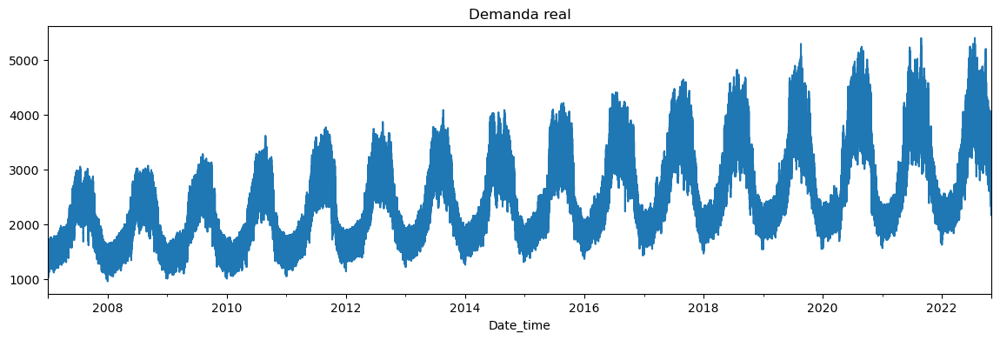

In [14]:
deman_td['Demanda'].plot(figsize =(14,4), title = 'Demanda real')

In [42]:
#All time boxplot
fig = go.Figure()
fig.add_trace(go.Box(x=deman_td['Demanda'], name='Energy Demand'))
fig.update_layout(title_text="Box Plot Energy Demand -  period 01/01/07-10/31/22", height=500) 
fig.show(renderer='notebook')

In [53]:
#Energy demand histogram
fig = px.histogram(deman_td, x="Demanda", nbins=12, title="Energy Demand histogram - period 01/01/07-10/31/22")
fig.show(renderer='notebook')

Archivo 2. Datos reales de temperaturas. Para este análisis nos enfocamos en las ciudades de Sonora.

In [15]:
#exploring available files 02
df_real = pd.read_csv('REAL_DIARIO_CONAGUA 20221031.csv', delimiter=',')
df_real.shape

(5783, 15)

In [16]:
#Keeping only columns of Sonora
df_real.drop(['TMAX-LMO','TMAX-CUL','TMIN-LMO','TMIN-CUL','PREC_LMO   (mm)','PREC_CUL   (mm)'], axis=1, inplace=True)
df_real.head(2)

,FECHA,TMAX-CAB,TMAX-HMO,TMAX-OBR,TMIN-CAB,TMIN-HMO,TMIN-OBR,PREC_HMO (mm),PREC_OBR (mm)
0,01/01/2007,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0
1,02/01/2007,20.5,22.0,22.0,1.8,7.0,7.0,0.0,0.5


In [17]:
df_real.describe()

,TMAX-CAB,TMAX-HMO,TMAX-OBR,TMIN-CAB,TMIN-HMO,TMIN-OBR,PREC_HMO (mm),PREC_OBR (mm)
count,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000,5783.000000
mean,32.998757,33.553745,34.537721,16.495575,18.503777,18.666749,1.398314,1.166718
std,7.801715,6.634979,5.928113,7.922205,7.057940,6.737775,6.940515,6.681513
min,9.090000,8.000000,12.000000,-6.800000,-3.000000,2.000000,0.000000,0.000000
25%,26.965000,28.720000,30.000000,10.100000,13.000000,13.000000,0.000000,0.000000
50%,33.730000,34.500000,35.410000,16.000000,18.000000,18.000000,0.000000,0.000000
75%,39.500000,39.000000,39.280000,23.565000,25.000000,25.000000,0.000000,0.000000
max,49.610000,49.100000,47.000000,32.900000,34.000000,42.500000,117.000000,166.800000


In [18]:
#Adjust Date to correct datatype
df_real['FECHA'] =  pd.to_datetime(df_real['FECHA'], format='%d/%m/%Y')

In [19]:
# Setting as index column date time
df_real.set_index("FECHA", inplace=True)

In [20]:
df_real.tail(4)
#df_real.columns

,TMAX-CAB,TMAX-HMO,TMAX-OBR,TMIN-CAB,TMIN-HMO,TMIN-OBR,PREC_HMO (mm),PREC_OBR (mm)
FECHA,,,,,,,,
2022-10-28,29.8,33.5,34.0,9.4,13.0,14.0,0.0,0.0
2022-10-29,29.0,32.0,33.0,9.2,12.0,16.0,0.0,0.0
2022-10-30,30.0,33.0,33.0,15.0,11.5,13.5,0.0,0.0
2022-10-31,29.0,31.5,31.5,15.0,16.0,14.0,0.0,0.0


In [21]:
df_real.isnull().sum() # check for null values

TMAX-CAB           0
TMAX-HMO           0
TMAX-OBR           0
TMIN-CAB           0
TMIN-HMO           0
TMIN-OBR           0
PREC_HMO   (mm)    0
PREC_OBR   (mm)    0
dtype: int64

In [22]:
#reviewing  actual temperatures
fig = go.Figure()
for col in df_real:
  if col == 'PREC_HMO   (mm)':
     pass
  elif col == 'PREC_OBR   (mm)':
     pass 
  else :
    fig.add_trace(go.Box(y=df_real[col].values, name=df_real[col].name))
    
  
fig.show(renderer='notebook')

In [23]:
#Eda
#report_actd = ProfileReport(df_real, title="Actual temperatures region Report")
#report_actd. to_file("Actualtrr_EDA.html")

Archivo 3.  dataset basado zonas de carga del estado, con las variables del tiempo real horaria de la fuente Meteomatics. 

In [24]:
#Explore file 3 ( Created from Meteomatics)
df_rlreg = pd.read_csv('real_met.csv', delimiter=",")
df_rlreg.shape

(674545, 14)

In [25]:
#verifying datatypes
df_rlreg['Fecha'].head()
#Adjust Date to correct datatype
df_rlreg['Fecha'] =  pd.to_datetime(df_rlreg['Fecha'], format='%d/%m/%Y')

In [26]:
df_rlreg.set_index = df_rlreg.set_index('Fecha') #set fecha as index

In [27]:
df_rlreg.columns
#print(np.unique(df_rlreg[['Gerencia']])) # identifying unique values

Index(['Gerencia', 'Zona_Carga', 'Estacion', 'API', 'Fecha', 'Hora',
       'Temperatura', 'Temperatura_Aparente', 'Precipitacion', 'Humedad',
       'Velocidad_Viento', 'Radiacion_Solar', 'Nubosidad', 'file'],
      dtype='object')

In [28]:
#Create new dataframes including only required columns
metr_columns=  ['Zona_Carga',
                 'Fecha',
                 'Hora',
                 'Temperatura',
                 'Temperatura_Aparente', 
                 'Precipitacion', 
                 'Humedad',
                 'Velocidad_Viento',  
                 'Radiacion_Solar', 
                 'Nubosidad']

df_mtrl = df_rlreg[metr_columns].copy() #creating a copy for tidy data
df_mtrl = df_mtrl.set_index('Fecha') #set fecha as index
df_mtrl.head(3)

,Zona_Carga,Hora,Temperatura,Temperatura_Aparente,Precipitacion,Humedad,Velocidad_Viento,Radiacion_Solar,Nubosidad
Fecha,,,,,,,,,
2010-01-01,Obregon,0,14.7,13.7,0.0,58.9,2.9,0.0,0.0
2010-01-01,Obregon,1,14.3,13.6,0.0,61.5,2.6,0.0,0.0
2010-01-01,Obregon,2,12.5,12.1,0.0,64.8,2.5,0.0,0.0


In [29]:
#in order to combine the files, we would not use date + time at this point
#df_mtrl.index = df_mtrl.Fecha + pd.to_timedelta(df_mtrl.Hora, unit='h')
#df_mtrl.head(4)

In [30]:
df_mtrl.isnull().sum() # check for null values

Zona_Carga              0
Hora                    0
Temperatura             0
Temperatura_Aparente    0
Precipitacion           0
Humedad                 0
Velocidad_Viento        0
Radiacion_Solar         0
Nubosidad               0
dtype: int64

In [31]:
#reviewing  actual temperatures
fig = go.Figure()
for col in df_mtrl:
  if col == 'Zona_Carga':
     pass
  elif col == 'Fecha':
     pass   
  elif col == 'Hora':
     pass  
  else :
    fig.add_trace(go.Box(y=df_mtrl[col].values, name=df_mtrl[col].name))

fig.show(renderer='notebook')

In [32]:
#Eda
#report_fore = ProfileReport(df_mtrl, title="forecasted temperatures region Report")
#report_fore. to_file("forecasted_trr_EDA.html")

### Join Dataframe. 
Uniremos el DF de demanda, con Temperatura real

In [33]:
deman_td2 = deman_td.set_index('FECHA') # TO Join the datasets, will be using Date wo time
db_com= deman_td2.join(df_real)
db_com.head()

,Demanda,Date,Hour,Month,Season,TMAX-CAB,TMAX-HMO,TMAX-OBR,TMIN-CAB,TMIN-HMO,TMIN-OBR,PREC_HMO (mm),PREC_OBR (mm)
FECHA,,,,,,,,,,,,,
2007-01-01,1297.0,0,1,1,Winter,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0
2007-01-01,1255.0,0,2,1,Winter,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0
2007-01-01,1222.0,0,3,1,Winter,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0
2007-01-01,1168.0,0,4,1,Winter,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0
2007-01-01,1128.0,0,5,1,Winter,21.0,21.5,25.0,2.0,9.0,7.5,0.0,0.0


In [34]:
#Create EDA for combined dataset, we set these as comments to avoid rerunning it
#report_comb = ProfileReport(db_com, title="Demanda vs temperatura real Sonora")
#report_comb. to_file("Demandatemp_EDA.html")

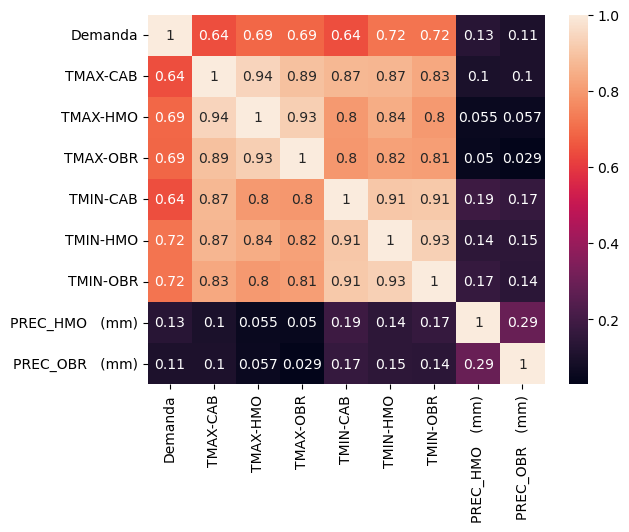

In [51]:
#correlations Matrix
import seaborn as sns
com_m = db_com[['Demanda','TMAX-CAB', 'TMAX-HMO', 'TMAX-OBR', 'TMIN-CAB',
       'TMIN-HMO', 'TMIN-OBR', 'PREC_HMO   (mm)','PREC_OBR   (mm)']].corr()
sns.heatmap(com_m, annot=True)
plt.show()


In [35]:
db_com.index = pd.to_datetime(db_com.index)

In [36]:
# Load the statsmodels api
import statsmodels.api as sm

In [37]:


#send combined dataframe to file
db_com.to_csv (r'dfcombined.csv', index = True)